In [1]:
import torch
from torch2trt import TRTModule
import random
import numpy as np
import os, json, cv2, random
import glob
from matplotlib import pyplot as plt
from PIL import Image
from trt_pose.coco import *
import torchvision.transforms as transforms
from trt_pose.parse_objects import ParseObjects

In [2]:
OPTIMIZED_MODEL = '/home/subella/src/trt_pose/tasks/target_pose/softdrone.pth'
model = TRTModule()
model.load_state_dict(torch.load(OPTIMIZED_MODEL))

<All keys matched successfully>

In [20]:
import json
import trt_pose.coco
with open('target_pose.json', 'r') as f:
    target_pose = json.load(f)
    
NUM_KEYPOINTS = 7
IMAGE_AREA = 234000


topology = trt_pose.coco.coco_category_to_topology(target_pose)
transform = torchvision.transforms.Compose([
            torchvision.transforms.ToTensor(),
            torchvision.transforms.Normalize([0.42174017, 0.39773076, 0.40150955], [0.25029679, 0.23943031, 0.25025475])
    ])
parse_objects = ParseObjects(topology, cmap_threshold=0.1, link_threshold=0.1, cmap_window=5, line_integral_samples=7, max_num_parts=100, max_num_objects=100)

def detect_keypoints(cv2_image, model):
    orig_image = Image.fromarray(cv2_image).convert("RGB")
    orig_image = orig_image.crop((0,
                                  0.5 * orig_image.height,
                                  orig_image.width, 
                                  orig_image.height))
    resize_factor = np.sqrt((orig_image.width * orig_image.height) / IMAGE_AREA)
    image_shape = (int(orig_image.width / resize_factor), int(orig_image.height / resize_factor))
    #ar = float(image.width) / float(image.height)
    ar = 1.0 
    quad = get_quad(0.0, (0, 0), 1.0, aspect_ratio=ar)
    image = transform_image(orig_image, image_shape, quad)
    #image.save("img.png")
    data = transform(image).cuda()[None, ...]
    cmap = model(data)
    cmap = cmap.cpu()
    object_counts, objects, peaks = parse_objects(cmap, cmap)
    object_counts, objects, peaks = int(object_counts[0]), objects[0], peaks[0]

    kps = [0]*(NUM_KEYPOINTS*3)
    for i in range(object_counts):
        object = objects[i]
        cnt = 0 
        for j in range(NUM_KEYPOINTS):
            k = object[j]
            if k >= 0:
                peak = peaks[j][k]
                if ar > 1.0: # w > h w/h
                    x = peak[1]
                    y = (peak[0] - 0.5) * ar + 0.5 
                else:
                    x = (peak[1] - 0.5) / ar + 0.5 
                    y = peak[0]

                x = round(float(orig_image.width * x)) 
                y = round(float(orig_image.height * y + orig_image.height))
                kps[j * 3 + 0] = x
                kps[j * 3 + 1] = y
                kps[j * 3 + 2] = 2
    return np.array(kps).reshape((NUM_KEYPOINTS,3))


# Teaser Evaluation Setup

In [4]:
import json
import seaborn as sns
from scipy.spatial.transform import Rotation as Rotation
import pandas as pd

Create some helper functions for coordinate frame conversion and Unity to ENU conversion:

In [5]:
# Converts Unity's left-handed coordinate system to ENU
# by swapping the y and z axes.
UNITY_TO_ENU = np.array([[1,0,0,0],
                         [0,0,1,0],
                         [0,1,0,0],
                         [0,0,0,1]])

CAMERA_TO_ENU = np.array([[1,0,0,0],
                         [0,0,1,0],
                         [0,-1,0,0],
                         [0,0,0,1]])

In [6]:
def transform_kpts(src, transformation):
    """
    Transforms array of positions by the transformation.

    Parameters
    ----------
    src : 3,x np array
        Positions in the original frame.
    transformation : 4,4 np array
        Transformation matrix.
        
    Returns
    -------
    3,x np array
        Positions in the transformed frame.

    """
    ones = np.ones(src.shape[1])
    src_homo_T = np.vstack((src, ones)).T
    dst = (src_homo_T.dot(transformation.T)).T[:3]
    return dst

def kpts_unity_to_enu_np(kpts_unity):
    """
    Converts a Unity keypoints dict to numpy array in ENU.

    Parameters
    ----------
    unity_keypoints : dict
        Contains keys "x", "y", "z" for positions
        in Unity's left-handed frame.

    Returns
    -------
    3x20 np array
        Array of keypoint positions.
        Rows are x,y,z.

    """
    kpts_np = np.zeros((3, len(kpts_unity)))
    for kpt_id in range(len(kpts_unity)):
        kpt = kpts_unity[kpt_id]
        kpt_np = pos_unity_to_np(kpt)
        kpts_np[:,kpt_id] = kpt_np.reshape((3,))
    kpts_enu = transform_kpts(kpts_np, UNITY_TO_ENU)
    return kpts_enu

def pos_unity_to_np(pos_unity):
    """
    Converts a Unity position dict to numpy array.

    Parameters
    ----------
    pos_unity : dict
        Contains keys "x", "y", "z" for position
        in Unity's left-handed frame.

    Returns
    -------
    3, np array
        Position vector in np format.

    """
    pos_np = np.array([pos_unity["x"], pos_unity["y"], pos_unity["z"]])
    return pos_np

def quat_unity_to_np(quat_unity):
    """
    Converts a Unity quaternion dict to numpy array.

    Parameters
    ----------
    quat_unity : dict
        Contains keys "x", "y", "z", "w" for quaternion
        in Unity's left-handed frame.

    Returns
    -------
    4, np array
        Quaternion in np format.

    """
    quat_np = np.array([quat_unity["x"], quat_unity["y"], quat_unity["z"], quat_unity["w"]])
    return quat_np

def quat_to_rot_matrix(quat):
    """
    Converts a quaternion to rotation matrix.

    Parameters
    ----------
    quat : 4, np array
        Quaternion in numpy format x, y, z, w.

    Returns
    -------
    3,3 np array
        Rotation matrix.

    """
    r = Rotation.from_quat(quat)
    rot_np = r.as_matrix()
    return rot_np
    
def make_transformation_matrix(rot, trans):
    """
    Creates a transformation matrix.

    Parameters
    ----------
    rot : 3,3 np array
        Rotation matrix.
    tras : 3, np array
        Translation vector.

    Returns
    -------
    4,4 np array
        Transformation matrix.

    """
    transformation = np.empty((4,4))
    transformation[:3, :3] = rot
    transformation[:3, 3] = trans
    transformation[3, :] = [0, 0, 0, 1]
    return transformation
        
def unity_to_enu_transformation(pos_unity, quat_unity):
    """
    Creates a transformation matrix from Unity to ENU.

    Parameters
    ----------
    pos_unity : dict
        Contains keys "x", "y", "z" for position
        in Unity's left-handed frame.
    quat_unity : dict
        Contains keys "x", "y", "z", "w" for quaternion
        in Unity's left-handed frame.

    Returns
    -------
    4,4 np array
        Transformation matrix.

    """
    
    quat_np = quat_unity_to_np(quat_unity)
    rot_matrix = quat_to_rot_matrix(quat_np)
    if pos_unity is not None:
        pos = pos_unity_to_np(pos_unity)
    else:
        pos = np.zeros((3,))
    
    transformation = make_transformation_matrix(rot_matrix, pos)
    unity_to_enu = UNITY_TO_ENU.dot(transformation).dot(UNITY_TO_ENU)
    return unity_to_enu

Evaluation and Visualization code:

In [7]:
import matplotlib as mpl
from mpl_toolkits.mplot3d import Axes3D
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.patches import FancyArrowPatch
from mpl_toolkits.mplot3d import proj3d


class Arrow3D(FancyArrowPatch):
    def __init__(self, xs, ys, zs, *args, **kwargs):
        FancyArrowPatch.__init__(self, (0, 0), (0, 0), *args, **kwargs)
        self._verts3d = xs, ys, zs
        
    def do_3d_projection(self, renderer=None):
        xs3d, ys3d, zs3d = self._verts3d
        xs, ys, zs = proj3d.proj_transform(xs3d, ys3d, zs3d, self.axes.M)
        self.set_positions((xs[0],ys[0]),(xs[1],ys[1]))

        return np.min(zs)

    def draw(self, renderer):
        xs3d, ys3d, zs3d = self._verts3d
        xs, ys, zs = proj3d.proj_transform(xs3d, ys3d, zs3d, renderer.M)
        self.set_positions((xs[0], ys[0]), (xs[1], ys[1]))
        FancyArrowPatch.draw(self, renderer)

def plot_tf(tf, ax, scale=1):
    arrow_prop_dict = dict(mutation_scale=20, arrowstyle='->', shrinkA=0, shrinkB=0)    
    a = Arrow3D([tf[0,3], tf[0,3] + tf[0,0]*scale], 
                [tf[1,3], tf[1,3] + tf[0,1]*scale], 
                [tf[2,3], tf[2,3] + tf[0,2]*scale], **arrow_prop_dict, color='r')
    ax.add_artist(a)
    a = Arrow3D([tf[0,3], tf[0,3] + tf[1,0]*scale], 
                [tf[1,3], tf[1,3] + tf[1,1]*scale], 
                [tf[2,3], tf[2,3] + tf[1,2]*scale], **arrow_prop_dict, color='b')
    ax.add_artist(a)
    a = Arrow3D([tf[0,3], tf[0,3] + tf[2,0]*scale], 
                [tf[1,3], tf[1,3] + tf[2,1]*scale], 
                [tf[2,3], tf[2,3] + tf[2,2]*scale], **arrow_prop_dict, color='g')
    ax.add_artist(a)


In [8]:
def plot_pose(tf, image, scale=100):
#     K = np.array([[615.221435546875, 0.0, 638.0890502929688],
#                   [0.0, 615.3164672851562, 368.7926025390625],
#                   [0.0, 0.0, 1.0]])
    K = np.array([[633.079618407961, 0.0, 640.545220714003],
                  [0.0, 623.765128390105, 349.179956567901],
                  [0.0, 0.0, 1.0]])
    
#     K = np.array([[629.1040649414062, 0.0, 637.203369140625], 
#                    [0.0, 628.583251953125, 380.56463623046875], 
#                    [0.0, 0.0, 1.0]])
    
    center = tf[:3,3].T
#     center = [0,0,1000]
    center_px = point_to_pixel(center, K)
    cv2.circle(image, center_px, 2, (255,0,0), 5)
    x_tip = center +  tf[:3,0] * scale
    x_tip_px = point_to_pixel(x_tip, K)
    cv2.line(image, center_px, x_tip_px, (255,0,0), 5)
    y_tip = center + tf[:3,1] * scale
    y_tip_px = point_to_pixel(y_tip, K)
    cv2.line(image, center_px, y_tip_px, (0,255,0), 5) 
    z_tip = center + tf[:3,2] * scale
    z_tip_px = point_to_pixel(z_tip, K)
    cv2.line(image, center_px, z_tip_px, (0,0,255), 5)
    return image

def plot_poses(est_tf, gt_tf, image):
    %matplotlib inline
    fig = plt.figure(figsize=(20, 20))
    image = plot_pose(est_tf, image)
    image = plot_pose(gt_tf, image)
    plt.imshow(image)
    plt.show()
    
def plot_keypoints(kps, image):
    %matplotlib inline
    fig = plt.figure(figsize=(20, 20))
    annotated_image = image.copy()
    for kp in kps:
        cv2.circle(annotated_image, (kp[0], kp[1]), 2, (255,0,0), 2)
    plt.imshow(annotated_image)
    plt.show()

def plot_tfs(est_tf, gt_tf):
    %matplotlib inline
    fig = plt.figure(figsize=(10, 10))
    ax = fig.add_subplot(111, projection='3d')
    x_delta = abs(est_tf[0,3] - gt_tf[0,3]) #max(est_tf[0,3], gt_tf[0,3]) - min(est_tf[0,3], gt_tf[0,3])
    y_delta = abs(est_tf[1,3] - gt_tf[1,3]) #max(est_tf[1,3], gt_tf[1,3]) - min(est_tf[1,3], gt_tf[1,3])
    z_delta = abs(est_tf[2,3] - gt_tf[2,3]) #max(est_tf[1,3], gt_tf[2,3]) - min(est_tf[2,3], gt_tf[2,3])
    max_delta = 1.2 * max(x_delta, y_delta, z_delta)
    mid_x = min(est_tf[0,3], gt_tf[0,3]) + x_delta / 2
    mid_y = min(est_tf[1,3], gt_tf[1,3]) + y_delta / 2
    mid_z = min(est_tf[2,3], gt_tf[2,3]) + z_delta / 2
    
    ax.set_xlabel('X')
    ax.set_xlim(mid_x - max_delta, mid_x + max_delta)
    ax.set_ylabel('Y')
    ax.set_ylim(mid_y - max_delta, mid_y + max_delta)
    ax.set_zlabel('Z')
    ax.set_zlim(mid_z - max_delta, mid_z + max_delta)
    
    plot_tf(est_tf, ax, scale=max_delta)
    plot_tf(gt_tf, ax, scale=max_delta)
#     ax.set_box_aspect((1.2 * x_delta, 1.2 * y_delta, 1.2 *z_delta))
    plt.show()

def plot_teaser(src, dst, est_dst=None, dst_gt_pose=None):
    """
    Plots keypoints for teaser visualization.

    Parameters
    ----------
    src : 3,x np array
        Keypoints in the target frame.
    dst : 3,x np array
        Ground truth keypoints wrt the camera frame.
    est_dst: 3,x np array
        dst keypoints computed using Teaser's pose 
        estimate and transforming each src keypoint.
    dst_gt_pose : 3,x np array
        dst keypoints computed using the ground truth
        pose and transforming each src keypoint.

    """
    %matplotlib inline
    fig = plt.figure(figsize=(10, 10))
    ax = fig.add_subplot(111, projection='3d')
    ax.scatter(src[0], src[1], src[2], c='green', label='src')
    ax.scatter(dst[0], dst[1], dst[2], c='red', label='dst')
    vals = np.hstack((src, dst))
    if est_dst is not None:
        vals = np.hstack((vals, est_dst))
        ax.scatter(est_dst[0], est_dst[1], est_dst[2], c='purple', label='est_dst')
    if dst_gt_pose is not None:
        vals = np.hstack((vals, dst_gt_pose))
        ax.scatter(dst_gt_pose[0], dst_gt_pose[1], dst_gt_pose[2], c='orange', label='transformed_dst')
    ax.legend()
    ax.set_box_aspect((np.ptp(vals[0]), np.ptp(vals[1]), np.ptp(vals[2])))
    plt.show()
    
def plot_samples(est_dst_kpts_arr, gt_dst_kpts_arr, est_transformation_arr, num_samples=3):
    for i in range(num_samples):
        est_dst_transformed = transform_kpts(src, est_transformation_arr[i])
        plot_teaser(src, gt_dst_kpts_arr[i], est_dst_kpts_arr[i], est_dst_transformed)
        
def evaluate_teaser(est_transformation_arr, gt_transformation_arr, data_name="Data"):
    """
    Computes error metrics on Teaser's performance.

    Parameters
    ----------
    est_transformation_arr : x,4,4 np array
        Estimated positions for each image.
    gt_transformation_arr : x,4,4 np array
        Ground truth positions for each image.

    """
    est_rot_arr = est_transformation_arr[:,:3,:3]
    gt_rot_arr = gt_transformation_arr[:,:3,:3]
    est_pos_arr = est_transformation_arr[:,:3,3]
    gt_pos_arr = gt_transformation_arr[:,:3,3]

    # Rotation error represents the angle between estimated and ground truth matrices:
    # theta = arccos( (tr(R) - 1) / 2), R = Rd'R
    R = np.matmul(gt_rot_arr.transpose((0,2,1)), est_rot_arr)

    cos_theta = np.clip((np.trace(R, axis1=1, axis2=2) - 1)/2, -1, 1)
    # rot_err_norms ia a (n,) array with each entry the rotation error formula above.
    rot_error_norms = np.arccos(cos_theta)
    rot_error_avg = np.mean(rot_error_norms)
    
    # pos_error_norms is a (n,) array with each entry the error norm for the
    # corresponding image.
    pos_error_norms = np.linalg.norm(est_pos_arr - gt_pos_arr, axis=1)
    # pos_error_avg averages all of the error norms for each image.
    pos_error_avg = np.mean(pos_error_norms)
    
    pos_error_norms = pd.DataFrame(pos_error_norms.T, columns = [data_name])
    rot_error_norms = pd.DataFrame(rot_error_norms.T, columns = [data_name])
    
    return pos_error_norms, rot_error_norms
    
def plot_errors(pos_error_norms, rot_error_norms, pos_max=None, rot_max=None):
    fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(15,7))
    if pos_max is not None:
        ax[0].set_xlim([0, pos_max])
    sns.histplot(pos_error_norms, ax=ax[0]).set_title("Position Errors (mm)")
#     sns.histplot(pos_error_norms, ax=ax[1]).set_title("Position Errors (m)")
    
#     fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(15,7))
    if rot_max is not None:
        ax[1].set_xlim(0, rot_max)
    sns.histplot(rot_error_norms, ax=ax[1]).set_title("Rotation Errors (rad)")
#     sns.histplot(rot_error_norms, ax=ax[1]).set_title("Rotation Errors (rad)")
    
def plot_errors_distance(pos_error_norms, rot_error_norms, gt_transformation_arr, column):
    distances = np.linalg.norm(gt_transformation_arr[:,:3,3], axis=1)
    distances = pd.DataFrame(distances, columns = ["Distance"])
    pos_error_norms = pd.concat([pos_error_norms, distances], axis=1)
    rot_error_norms = pd.concat([rot_error_norms, distances], axis=1)
    fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(15,7))
    sns.regplot("Distance", column, data=pos_error_norms, ax=ax[0]).set_title("{} Position Errors (mm)".format(column))
    sns.regplot("Distance", column, data=rot_error_norms, ax=ax[1]).set_title("{} Rotation Errors (rad)".format(column))
    ax[0].set(xlabel='Distance', ylabel='Error')
    ax[1].set(xlabel='Distance', ylabel='Error')

Teaser specific utils:

In [9]:
def estimate_pose(solver, src, dst):
    # Populate the parameters    
    solver.solve(src, dst)
    solution = solver.getSolution()
    return solution.translation.copy(), solution.rotation.copy()

def get_src_kpts(data):
    # Positions of the keypoints in the CAD frame.
    src_kpts = data["keypointFrame"]["localKeypoints"]
    src_kpts_wrt_cam = kpts_unity_to_enu_np(src_kpts)
    return src_kpts_wrt_cam

def get_est_tar_wrt_cam_tf(solver, src_kpts_wrt_cam, dst_kpts_wrt_cam):
    """
        Returns the transform of target wrt cam using teaser 
        with ground truth keypoints
    """

    # By construction the transform src wrt world is the identity.
    gt_src_wrt_cam_tf = np.eye(4)

    # Target's tf relative to the keypoints CAD frame.
    est_tar_wrt_src_pos, est_tar_wrt_src_rot = estimate_pose(solver, src_kpts_wrt_cam, dst_kpts_wrt_cam)
    est_tar_wrt_src_tf = make_transformation_matrix(est_tar_wrt_src_rot, est_tar_wrt_src_pos)

    est_tar_wrt_cam_tf = np.matmul(est_tar_wrt_src_tf, gt_src_wrt_cam_tf)
    return est_tar_wrt_cam_tf

def get_gt_tar_wrt_cam_tf(annotation):
    """
        Computes ground truth transformation matrix of target wrt camera.
    """
    gt_tar_wrt_cam_pos_unity = annotation["localPosition"]
    gt_tar_wrt_cam_rot_unity = annotation["localRotation"]
    gt_tar_wrt_cam_tf = unity_to_enu_transformation(gt_tar_wrt_cam_pos_unity, gt_tar_wrt_cam_rot_unity)
    return gt_tar_wrt_cam_tf

def get_gt_tar_wrt_cam_tf_hardware(annotation):
    gt_tar_wrt_cam_pos = annotation["localPosition"].copy()
    gt_tar_wrt_cam_rot = annotation["localRotation"].copy()
    gt_tar_wrt_cam_rot.append(gt_tar_wrt_cam_rot.pop(0))
    gt_tar_wrt_cam_rot = quat_to_rot_matrix(gt_tar_wrt_cam_rot)
    gt_tar_wrt_cam_tf = make_transformation_matrix(gt_tar_wrt_cam_rot, gt_tar_wrt_cam_pos)
    return gt_tar_wrt_cam_tf

#  Ground Truth Keypoint Detections

In [10]:
def get_all_ids(visibility):
    """
    Placeholder function that does not filter out any 
    invisible keypoints
    """
    best_ids = np.indices(visibility.shape)[0]
    return best_ids
    
def get_best_ids(visibility):
    """
    Returns an index array containing the visible keypoints.
    """
    best_ids = np.argpartition(visibility, -15)[-15:]
    return best_ids

def get_visible_ids(visibility):
    return np.where(visibility == 2)[0]
    
def get_gt_kpts(annotation):
    """
    Returns the true ground truth world coordinates.
    """
    gt_kpts_wrt_cam_unity = annotation["groundTruthKeypoints"]
    dst_kpts_wrt_cam = kpts_unity_to_enu_np(gt_kpts_wrt_cam_unity)
    
    # TODO: Visibility information is only store in the "keypoints" entry.
    gt_kpts_wrt_cam_pix_unity = annotation["keypoints"]
    gt_kpts_wrt_cam_pix = kpts_pix_unity_to_np(gt_kpts_wrt_cam_pix_unity)
    visibility = gt_kpts_wrt_cam_pix[:,2]
    dst_kpts_wrt_cam = np.vstack((dst_kpts_wrt_cam, visibility.T))
    
    return dst_kpts_wrt_cam

def get_gt_kpts_hardware(annotation):
    gt_kpts_wrt_cam_pix_unity = annotation["keypoints"]
    gt_kpts_wrt_cam_pix = kpts_pix_unity_to_np(gt_kpts_wrt_cam_pix_unity)
    dst_kpts_wrt_cam = np.array(annotation["groundTruthKeypoints"]).T
    return gt_kpts_wrt_cam_pix, dst_kpts_wrt_cam

# Depth Keypoint Detections

In [ ]:
def point_to_pixel(point, K):
    fx = K[0,0]
    fy = K[1,1]
    cx = K[0,2]
    cy = K[1,2]
    px = int((fx * point[0] / point[2] + cx))
    py = int((fy * point[1] / point[2] + cy))
    return [px, py]

def pixels_to_meters(px, py, z, K):
    """
        Convert pixel coordinates + depth to world coordinates.
    """
    fx = K[0,0]
    fy = K[1,1]
    cx = K[0,2]
    cy = K[1,2]
    x = (px - cx) * z / fx
    y = (py - cy) * z / fy
    pos = np.array([x, y, z])
    return pos

def kpts_pix_unity_to_np(kpts, filter_visible=True):
    """
        Convert a list of kpts in the form 
        [px1, py1, v1, ..., pxn, pyn, vn]
        to:
        [[px1,py1],
         ...
         [pxn, pyn]]
    """
    kpts_np = np.array(kpts).astype(int)
    kpts_np = kpts_np.reshape((len(kpts)//3, 3))
    return kpts_np

def get_depth_kpts(annotation, kpts_wrt_cam_pix):
    """
        Returns keypoints in meters using depth info and
        ground truth pixel coordinates.
    """
    depth_image_name = teaser_folder + annotation["depth_file_name"]
    depth_image_rgba = cv2.imread(depth_image_name,cv2.IMREAD_UNCHANGED)
    depth_image_bgra = cv2.cvtColor(depth_image_rgba, cv2.COLOR_RGBA2BGRA)
    
    # Converts BGRA to float array.
    coeffs = np.array([1.0, 1/255., 1/(255.**2), 1/(255.**3)])
    depth_image = np.dot(depth_image_bgra, coeffs).astype('float32')  
    depth_image /= 255.0
    
    # Multiply by far render distance to get values in meters. (TODO: hardcoded)
    depth_image *= 50

    px = np.clip(kpts_wrt_cam_pix[:,0].astype(int), 0, 719)
    py = np.clip(kpts_wrt_cam_pix[:,1].astype(int), 0 , 479)
    z = depth_image[py,px]

    # Hardcoded camera matrix from tesse.
    K = np.array([[415.69219381653056, 0.0, 360.0],
                  [0.0, 415.69219381653056, 240.0],
                  [0.0, 0.0, 1.0]])

    # Get the 3D coordinate for each keypoint 
    est_kpts_wrt_cam = pixels_to_meters(px, py, z, K)
    
    # Convert camera coordinate frame to ENU
    est_kpts_wrt_cam_enu = transform_kpts(est_kpts_wrt_cam, CAMERA_TO_ENU)
    
    # Append visibility info to array.
    est_kpts_wrt_cam_enu = np.vstack((est_kpts_wrt_cam_enu, kpts_wrt_cam_pix[:,2].T))
    return est_kpts_wrt_cam_enu

def get_depth_kpts_hardware(annotation, kpts_wrt_cam_pix):
    """
        Returns keypoints in meters using depth info and
        ground truth pixel coordinates.
    """
    depth_image_name = teaser_folder + annotation["depth_file_name"]
    depth_image = cv2.imread(depth_image_name,cv2.IMREAD_UNCHANGED)   

    px = np.clip(kpts_wrt_cam_pix[:,0].astype(int), 0, 1279)
    py = np.clip(kpts_wrt_cam_pix[:,1].astype(int), 0 , 719)
    z = depth_image[py,px]

#     Hardcoded camera matrix.
#     K = np.array([[615.221435546875, 0.0, 638.0890502929688],
#                   [0.0, 615.3164672851562, 368.7926025390625],
#                   [0.0, 0.0, 1.0]])
    
    K = np.array([635.2426147460938, 0.0, 643.0897216796875]
                 [0.0, 634.5845336914062, 370.1532592773437]
                 [0.0, 0.0, 1.0])

#     K = np.array([[629.1040649414062, 0.0, 637.203369140625], 
#                    [0.0, 628.583251953125, 380.56463623046875], 
#                    [0.0, 0.0, 1.0]])

    # Get the 3D coordinate for each keypoint 
    est_kpts_wrt_cam = pixels_to_meters(px, py, z, K)

#     est_kpts_wrt_cam.T[:,:2] = np.array(annotation["groundTruthKeypoints"])[:,:2]
    
    # Convert camera coordinate frame to ENU
#     est_kpts_wrt_cam_enu = transform_kpts(est_kpts_wrt_cam, CAMERA_TO_ENU)
    
    # Append visibility info to array.
    est_kpts_wrt_cam_enu = np.vstack((est_kpts_wrt_cam, kpts_wrt_cam_pix[:,2].T))
    return est_kpts_wrt_cam_enu

def get_depth_gt_kpts(annotation):
    gt_kpts_wrt_cam_pix_unity = annotation["keypoints"]
    # The ground truth keypoints' pixels (px, py) wrt to the camera frame using
    # a camera coordinate system. (z forward, x right, y down)
    gt_kpts_wrt_cam_pix = kpts_pix_unity_to_np(gt_kpts_wrt_cam_pix_unity)
    return gt_kpts_wrt_cam_pix, get_depth_kpts(annotation, gt_kpts_wrt_cam_pix)

def get_depth_gt_kpts_hardware(annotation):
    gt_kpts_wrt_cam_pix_unity = annotation["keypoints"]
    # The ground truth keypoints' pixels (px, py) wrt to the camera frame using
    # a camera coordinate system. (z forward, x right, y down)
    gt_kpts_wrt_cam_pix = kpts_pix_unity_to_np(gt_kpts_wrt_cam_pix_unity)
    return gt_kpts_wrt_cam_pix, get_depth_kpts_hardware(annotation, gt_kpts_wrt_cam_pix)

# Neural Net + Depth Keypoint Predictions

In [12]:
def get_nn_visible_ids(visibility):
    visible_ids = np.where(visibility > 0.0)[0]
    return visible_ids

def get_depth_nn_kpts(annotation):
    rgb_image_name = teaser_folder + annotation["file_name"]
    bgr_image = cv2.imread(rgb_image_name)
    rgb_image = cv2.cvtColor(bgr_image, cv2.COLOR_BGR2RGB)
    
    model = model_no_detectron
    est_kpts_wrt_cam_pix = model(rgb_image)
    
    if est_kpts_wrt_cam_pix is None:
        return None
    
    est_kpts_wrt_cam_pix = est_kpts_wrt_cam_pix.cpu().detach().numpy()[:,:3]
    return get_depth_kpts(annotation, est_kpts_wrt_cam_pix)

def get_depth_nn_kpts_hardware(annotation):
    rgb_image_name = teaser_folder + annotation["depth_file_name"]
    rgb_image_name = rgb_image_name.replace("depth", "rgb")
    rgb_image = cv2.imread(rgb_image_name)
    
#     model = model_no_detectron
    est_kpts_wrt_cam_pix = detect_keypoints(rgb_image, model)
    
    if est_kpts_wrt_cam_pix is None:
        return None
    
    est_kpts_wrt_cam_pix = est_kpts_wrt_cam_pix[:,:3]
    return est_kpts_wrt_cam_pix, get_depth_kpts_hardware(annotation, est_kpts_wrt_cam_pix)

def get_gt_depth_nn_kpts(annotation):
    rgb_image_name = teaser_folder + annotation["depth_file_name"]
    rgb_image_name = rgb_image_name.replace("depth", "rgb")
    rgb_image = cv2.imread(rgb_image_name)
    est_kpts_wrt_cam_pix = detect_keypoints(rgb_image, model)
    if est_kpts_wrt_cam_pix is None:
        return None
    est_kpts_wrt_cam_enu = get_depth_kpts_hardware(annotation, est_kpts_wrt_cam_pix)
    est_kpts_wrt_cam_enu[2,:] = np.array(annotation["groundTruthKeypoints"]).T[2,:]
    return est_kpts_wrt_cam_pix, est_kpts_wrt_cam_enu
    

# Teaser Evaluation

In [13]:
def compute_test_set(data, solver_params, get_est_kpts, filter_best=False):

    annotations = data["annotations"]
    # TODO: Make consistent between unity and hardware.
#     gt_src_kpts_wrt_cam = get_src_kpts(data)
    gt_src_kpts_wrt_cam = np.array(data['keypointFrame']['localKeypoints']).T
    
    gt_transformation_arr = np.zeros((len(annotations),4,4))
    est_transformation_arr = np.zeros((len(annotations),4,4))
    gt_dst_kpts_arr = np.zeros((len(annotations), 
                                gt_src_kpts_wrt_cam.shape[0],
                                gt_src_kpts_wrt_cam.shape[1]))
    est_dst_kpts_arr = np.zeros((len(annotations), 
                                gt_src_kpts_wrt_cam.shape[0],
                                gt_src_kpts_wrt_cam.shape[1]))
    failures = 0
    
    for annotation_id, annotation in enumerate(annotations):
        solver = teaserpp_python.RobustRegistrationSolver(solver_params)

        gt_dst_kpts_wrt_cam_pix, gt_dst_kpts_wrt_cam = get_gt_kpts_hardware(annotation)
        est_dst_kpts_wrt_cam_pix, est_dst_kpts_wrt_cam = get_est_kpts(annotation)
        
        if est_dst_kpts_wrt_cam is None:
            print("Error getting keypoints")
            failures += 1
            continue
        
        if filter_best:
            est_best_ids = get_visible_ids(est_dst_kpts_wrt_cam[3])
            # TODO: IT's probably better to just leave keypoints as (n,4) and transpose
            # for final step.
            src = (gt_src_kpts_wrt_cam.T[est_best_ids].T)[:3]
            dst = (est_dst_kpts_wrt_cam.T[est_best_ids].T)[:3]
        else:
            src = gt_src_kpts_wrt_cam[:3]
            dst = est_dst_kpts_wrt_cam[:3]
        
        if (src.shape[1] <= 3):
            print("Too little keypoints!")
            failures += 1
            continue
        
        gt_tar_wrt_cam_tf = get_gt_tar_wrt_cam_tf_hardware(annotation)
        est_tar_wrt_cam_tf = get_est_tar_wrt_cam_tf(solver, 
                                                    src, 
                                                    dst)
        
#         print("GT", gt_tar_wrt_cam_tf)
#         print("EST", est_tar_wrt_cam_tf)
        
        gt_transformation_arr[annotation_id] = gt_tar_wrt_cam_tf
        est_transformation_arr[annotation_id] = est_tar_wrt_cam_tf
        
        gt_dst_kpts_arr[annotation_id] = gt_dst_kpts_wrt_cam[:3]
        est_dst_kpts_arr[annotation_id] = est_dst_kpts_wrt_cam[:3]
        
        rgb_image_name = teaser_folder + annotation["depth_file_name"]
        rgb_image_name = rgb_image_name.replace("depth", "rgb")
        rgb_image = cv2.imread(rgb_image_name)
        
        plot_keypoints(est_dst_kpts_wrt_cam_pix, rgb_image)
        plot_poses(est_tar_wrt_cam_tf, gt_tar_wrt_cam_tf, rgb_image)
        plot_teaser(src, gt_dst_kpts_wrt_cam[:3], dst, transform_kpts(src, est_tar_wrt_cam_tf))
        plot_tfs(est_tar_wrt_cam_tf, gt_tar_wrt_cam_tf)
    
    print("{} out of {} images failed".format(failures, len(annotations)))
    return gt_transformation_arr, est_transformation_arr, gt_dst_kpts_arr, est_dst_kpts_arr

Plot the first annotated keypoint frame for a sanity check:

In [14]:
teaser_folder = "/home/subella/src/AutomatedAnnotater/Data/PepsiBottleMocap/Datasets/Validation/2023-01-09-12-53-11/"

# Open the data folder and parse the metadata into a python dict.
with open(teaser_folder + "metadata.json") as json_file:
    data = json.load(json_file)

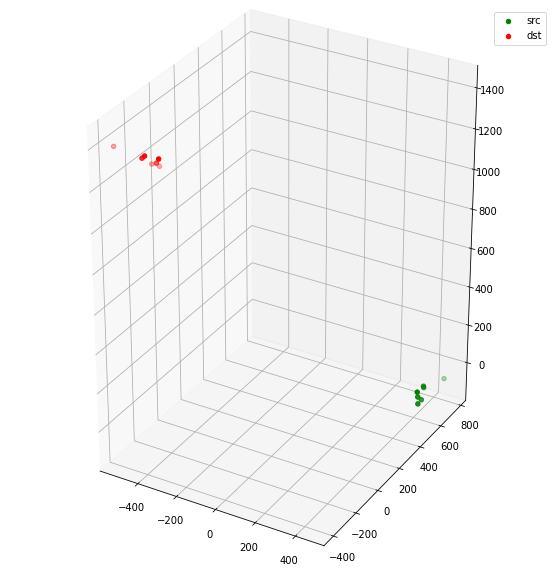

In [15]:
src_kpts = data["keypointFrame"]["localKeypoints"]
dst_kpts = data["annotations"][0]["groundTruthKeypoints"]

# src = kpts_unity_to_enu_np(src_kpts)
# dst = kpts_unity_to_enu_np(dst_kpts)

src = np.array(src_kpts)
dst = np.array(dst_kpts)

plot_teaser(src.T, dst.T)

Initialize the solver:

In [16]:
import teaserpp_python

# Initialize Teaser Solver
solver_params = teaserpp_python.RobustRegistrationSolver.Params()
solver_params.cbar2 = 1
solver_params.noise_bound = 15
solver_params.estimate_scaling = False
solver_params.rotation_estimation_algorithm = (
    teaserpp_python.RobustRegistrationSolver.ROTATION_ESTIMATION_ALGORITHM.GNC_TLS
)
solver_params.rotation_gnc_factor = 1.4
solver_params.rotation_max_iterations = 100
solver_params.rotation_cost_threshold = 1e-6

print("TEASER++ Parameters are:", solver_params)

TEASER++ Parameters are: <Params with noise_bound=15
cbar2=1
estimate_sccaling=0
rotation_estimation_algorithm=GNC-TLS
inlier_selection_mode=PMC_EXACT
>


In [17]:
def evaluate_comparison(data, solver_params):
#     gt_transformation_arr, est_transformation_arr,\
#     gt_dst_kpts_arr, est_dst_kpts_arr = compute_test_set(data, solver_params, get_gt_kpts_hardware)
#     gt_pos_error_norms, gt_rot_error_norms = evaluate_teaser(est_transformation_arr, 
#                                                              gt_transformation_arr, 
#                                                              data_name="Ground Truth")
    
    
#     gt_transformation_arr, est_transformation_arr,\
#     gt_dst_kpts_arr, est_dst_kpts_arr = compute_test_set(data, solver_params, get_gt_kpts, filter_best=True)
#     gt_pos_error_norms_filt, gt_rot_error_norms_filt = evaluate_teaser(est_transformation_arr,
#                                                                        gt_transformation_arr,
#                                                                        data_name="Ground Truth Filt")

#     gt_transformation_arr, est_transformation_arr,\
#     gt_dst_kpts_arr, est_dst_kpts_arr = compute_test_set(data, solver_params, get_depth_gt_kpts_hardware)
#     depth_pos_error_norms, depth_rot_error_norms = evaluate_teaser(est_transformation_arr, 
#                                                                    gt_transformation_arr,
#                                                                    data_name="Depth")

#     gt_transformation_arr, est_transformation_arr,\
#     gt_dst_kpts_arr, est_dst_kpts_arr = compute_test_set(data, solver_params, get_depth_gt_kpts, filter_best=True)
#     depth_pos_error_norms_filt, depth_rot_error_norms_filt = evaluate_teaser(est_transformation_arr, 
#                                                                              gt_transformation_arr,
#                                                                              data_name="Depth Filt")

    gt_transformation_arr, est_transformation_arr,\
    gt_dst_kpts_arr, est_dst_kpts_arr = compute_test_set(data, solver_params, get_depth_nn_kpts_hardware)
    nn_pos_error_norms, nn_rot_error_norms = evaluate_teaser(est_transformation_arr, 
                                                             gt_transformation_arr,
                                                             data_name="Detector")
    
    
#     gt_transformation_arr, est_transformation_arr,\
#     gt_dst_kpts_arr, est_dst_kpts_arr = compute_test_set(data, solver_params, get_gt_depth_nn_kpts)
#     nn_gt_depth_pos_error_norms, nn_gt_depth_rot_error_norms = evaluate_teaser(est_transformation_arr, 
#                                                                                gt_transformation_arr,
#                                                                                data_name="Detector with GT Depth")

#     bad_ids =  nn_gt_depth_pos_error_norms.index[nn_gt_depth_pos_error_norms['Detector with GT Depth'] > 50].tolist()
#     print(bad_ids)
#     for idx in bad_ids:
#         plot_tfs(est_transformation_arr[idx], gt_transformation_arr[idx])
#         print("EST: ", est_transformation_arr[idx])
#         print("GT: ", gt_transformation_arr[idx])
#     print(nn_gt_depth_pos_error_norms)
#     gt_transformation_arr, est_transformation_arr,\
#     gt_dst_kpts_arr, est_dst_kpts_arr = compute_test_set(data, solver_params, get_depth_nn_kpts_hardware, filter_best=True)
#     nn_pos_error_norms_filt, nn_rot_error_norms_filt = evaluate_teaser(est_transformation_arr,
#                                                                        gt_transformation_arr,
#                                                                        data_name="Detector Filt")
#     gt_transformation_arr, est_transformation_arr,\
#     gt_dst_kpts_arr, est_dst_kpts_arr = compute_test_set(data, solver_params, get_gt_depth_nn_kpts, filter_best=True)
#     nn_gt_depth_pos_error_norms_filt, nn_gt_depth_rot_error_norms_filt = evaluate_teaser(est_transformation_arr, 
#                                                                                gt_transformation_arr,
#                                                                                data_name="Detector with GT Depth Filt")

#     pos_error_norms = pd.concat([gt_pos_error_norms, gt_pos_error_norms_filt,
#                                  depth_pos_error_norms, depth_pos_error_norms_filt,
#                                  nn_pos_error_norms, nn_pos_error_norms_filt], axis=1)
    
#     rot_error_norms = pd.concat([gt_rot_error_norms, gt_pos_error_norms_filt,
#                                  depth_rot_error_norms, depth_rot_error_norms_filt,
#                                  nn_rot_error_norms, nn_rot_error_norms_filt], axis=1)

#     pos_error_norms = pd.concat([gt_pos_error_norms, depth_pos_error_norms, nn_pos_error_norms], axis=1)
#     rot_error_norms = pd.concat([gt_rot_error_norms, depth_rot_error_norms, nn_rot_error_norms], axis=1)

#     pos_error_norms = pd.concat([nn_pos_error_norms, nn_gt_depth_pos_error_norms, nn_pos_error_norms_filt, nn_gt_depth_pos_error_norms_filt], axis=1)
#     rot_error_norms = pd.concat([nn_rot_error_norms, nn_gt_depth_rot_error_norms, nn_rot_error_norms_filt, nn_gt_depth_rot_error_norms_filt], axis=1)
    pos_error_norms = pd.concat([nn_pos_error_norms], axis=1)
    rot_error_norms = pd.concat([nn_rot_error_norms], axis=1)
    return pos_error_norms, rot_error_norms, gt_transformation_arr

def plot_comparison(pos_error_norms, rot_error_norms):
    # Plotting
    plot_errors(pos_error_norms[["Depth", "Depth Filt"]], 
                rot_error_norms[["Depth", "Depth Filt"]],
                pos_max=0.05, rot_max=0.5)
    
    plot_errors(pos_error_norms[["Detector", "Detector Filt"]], 
                rot_error_norms[["Detector", "Detector Filt"]],
                pos_max=None, rot_max=None)
    
    plot_errors(pos_error_norms[["Ground Truth", "Depth", "Detector"]], 
                rot_error_norms[["Ground Truth", "Depth", "Detector"]],
                pos_max=0.05, rot_max=0.2)

# Easy Test Set

In [18]:
teaser_folder = "/home/subella/src/AutomatedAnnotater/Data/PepsiBottleMocap/Datasets/Validation/2023-01-09-12-53-11/"

# Open the data folder and parse the metadata into a python dict.
with open(teaser_folder + "metadata.json") as json_file:
    data = json.load(json_file)

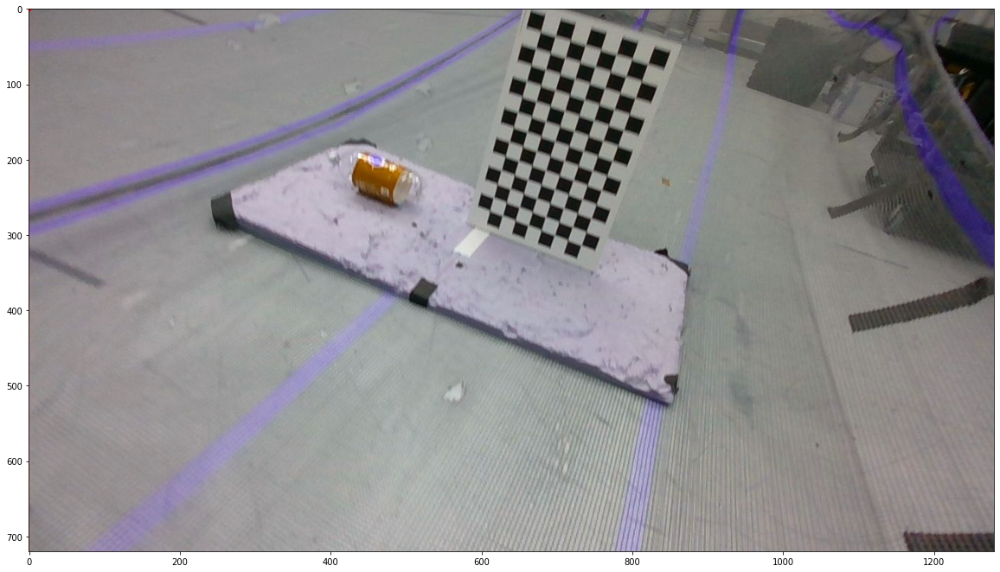

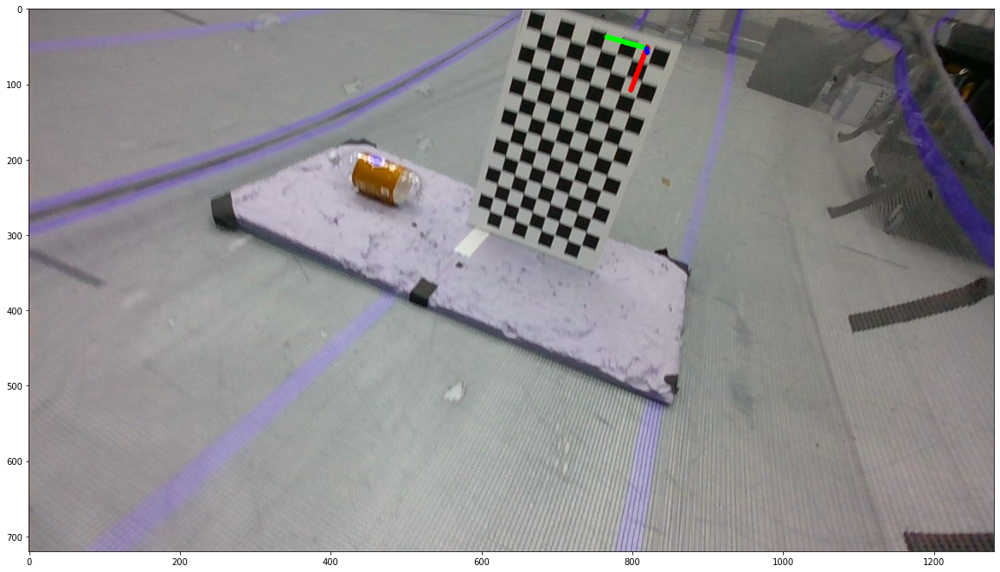

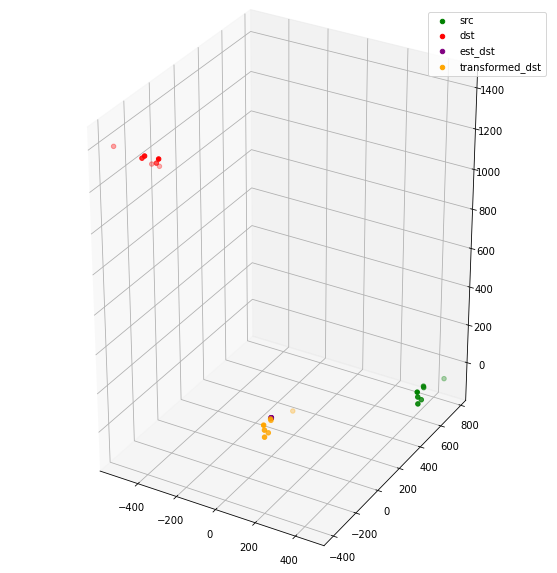

/usr/lib/python3/dist-packages/ipykernel_launcher.py:23: MatplotlibDeprecationWarning: 
The M attribute was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use self.axes.M instead.


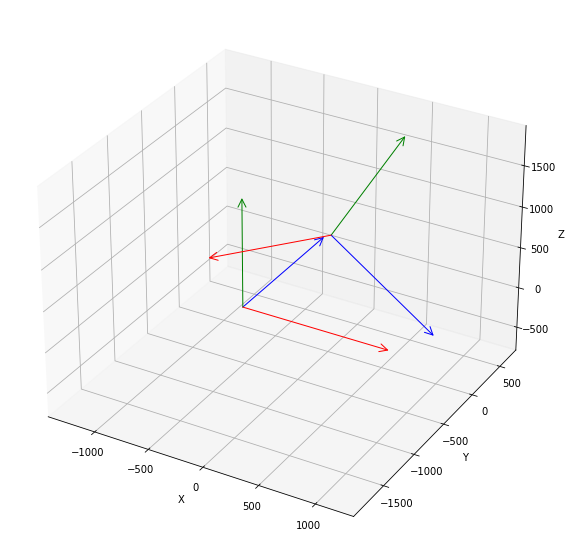

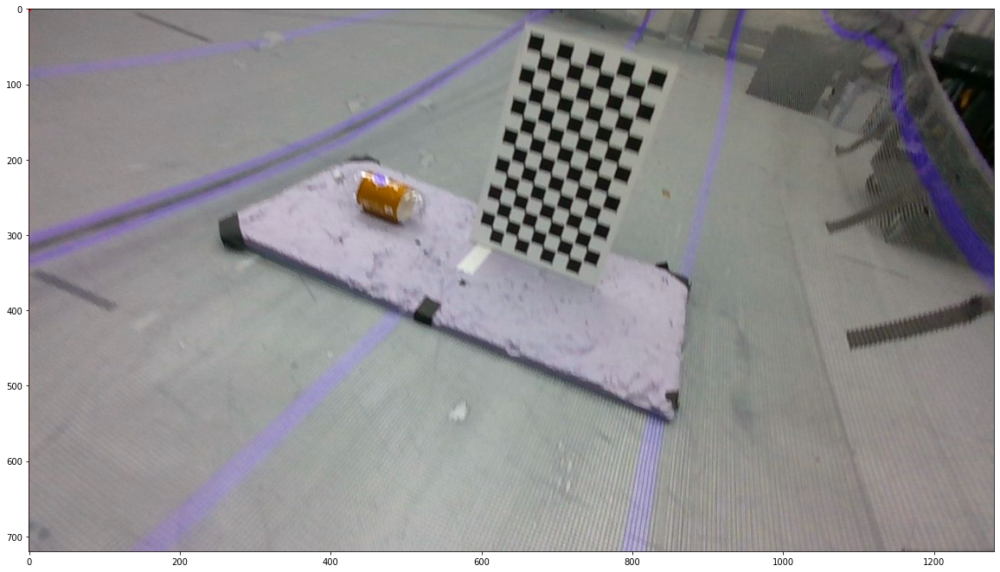

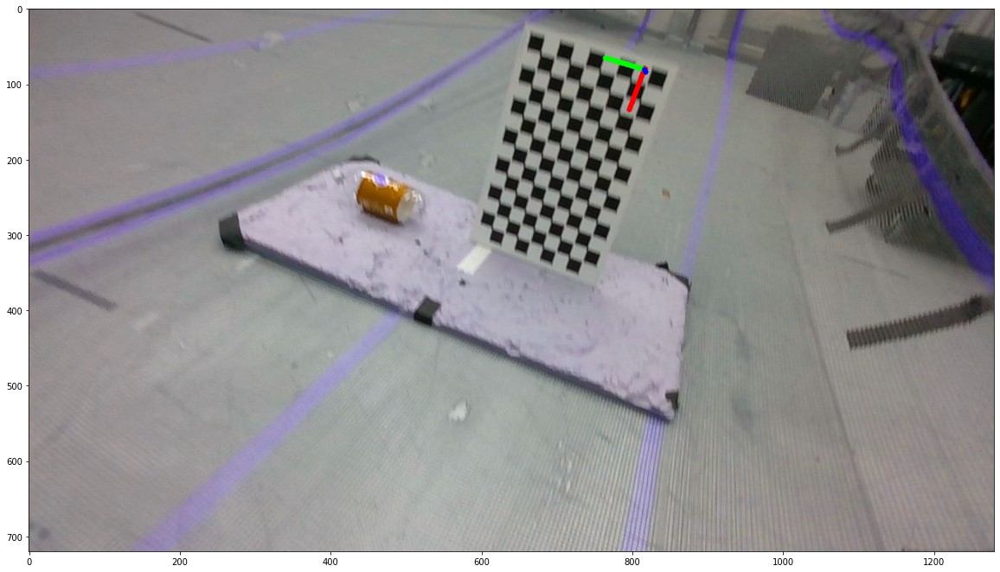

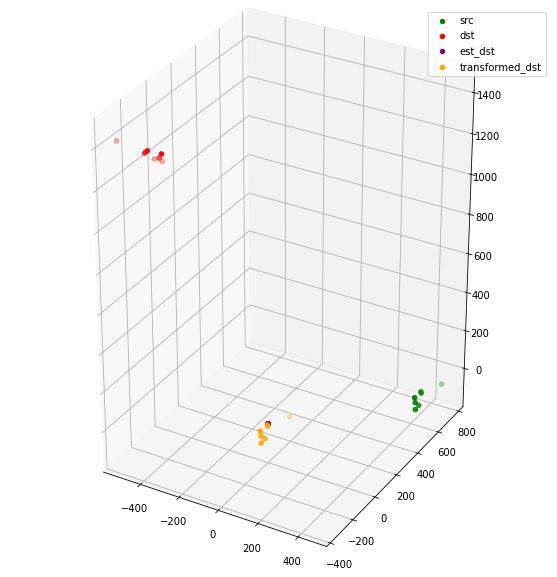

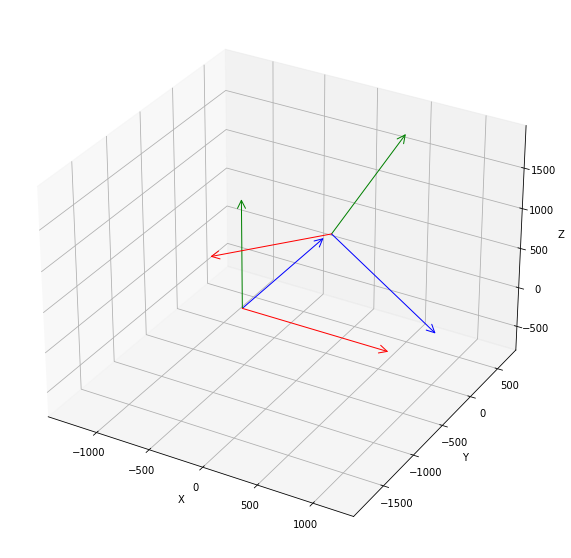

...

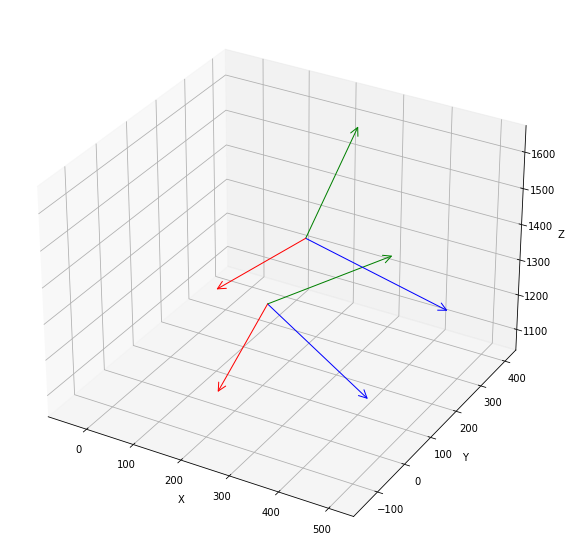

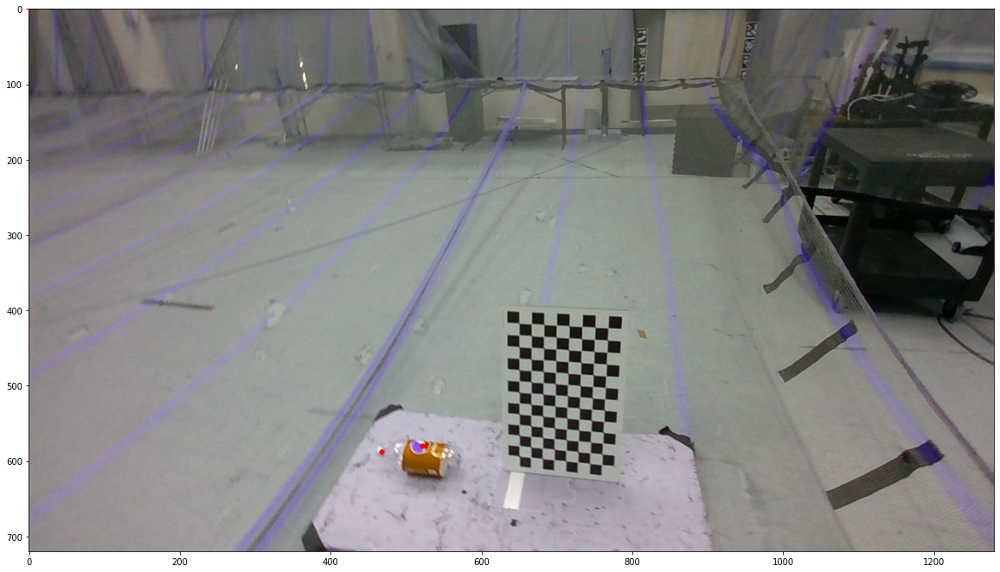

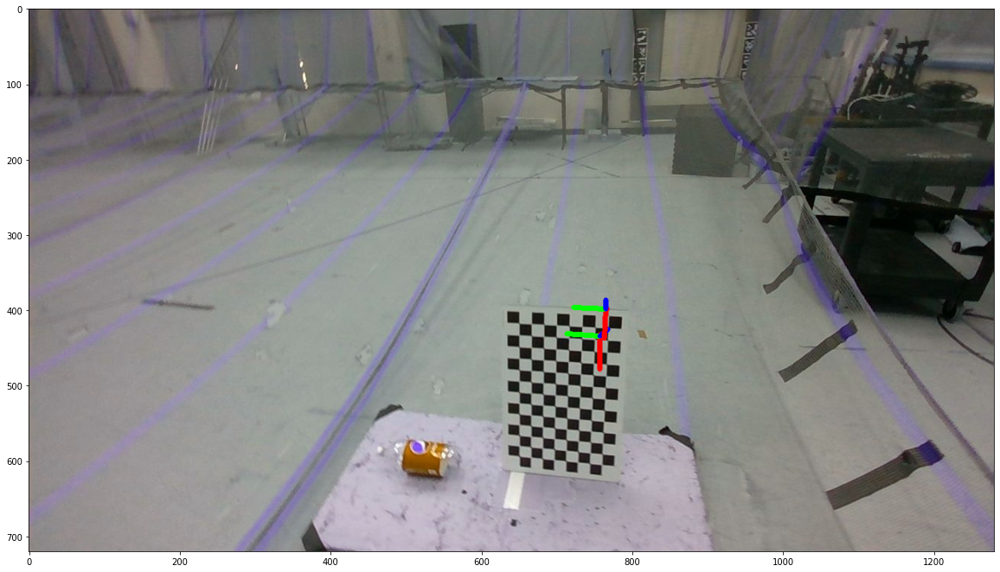

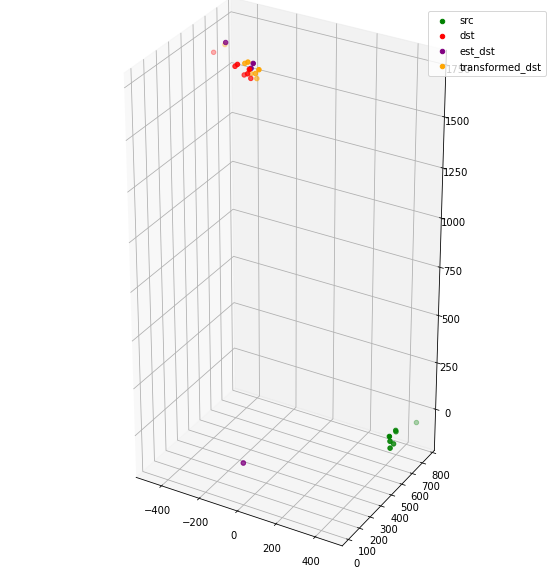

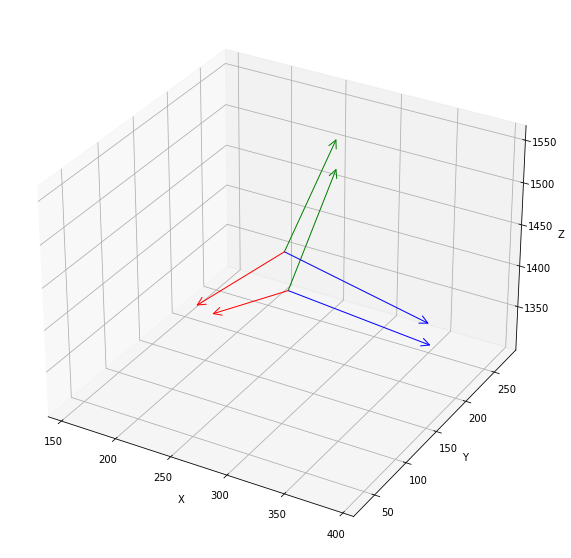

KeyboardInterrupt: 

In [22]:
easy_pos_error_norms, easy_rot_error_norms, gt_transformation_arr = evaluate_comparison(data, solver_params)

In [ ]:
print(data)

In [ ]:
# plot_comparison(pos_error_norms, rot_error_norms)
# plot_errors(easy_pos_error_norms[["Ground Truth"]], 
#             easy_rot_error_norms[["Ground Truth"]],
#             pos_max=300, rot_max=0.3)

# plot_errors(easy_pos_error_norms[["Depth"]], 
#             easy_rot_error_norms[["Depth"]],
#             pos_max=300, rot_max=0.3)

# plot_errors(easy_pos_error_norms[["Detector"]], 
#             easy_rot_error_norms[["Detector"]],
#             pos_max=300, rot_max=0.3)

# plot_errors(easy_pos_error_norms[["Detector", "Detector Filt"]], 
#             easy_rot_error_norms[["Detector", "Detector Filt"]],
#             pos_max=0.1, rot_max=0.5)

# plot_errors(easy_pos_error_norms[["Ground Truth", "Depth", "Detector"]], 
#             easy_rot_error_norms[["Ground Truth", "Depth", "Detector"]],
#             pos_max=300, rot_max=0.3)

# plot_errors(easy_pos_error_norms[["Detector", "Detector with GT Depth", "Detector Filt", "Detector with GT Depth Filt"]], 
#             easy_rot_error_norms[["Detector", "Detector with GT Depth", "Detector Filt", "Detector with GT Depth Filt"]],
#            pos_max=300, rot_max = 0.3)

plot_errors(easy_pos_error_norms[["Detector"]], 
            easy_rot_error_norms[["Detector"]])

In [ ]:
# plot_errors_distance(easy_pos_error_norms, easy_rot_error_norms, gt_transformation_arr, "Ground Truth")
# plot_errors_distance(easy_pos_error_norms, easy_rot_error_norms, gt_transformation_arr, "Depth")
plot_errors_distance(easy_pos_error_norms, easy_rot_error_norms, gt_transformation_arr, "Detector")

# Hard Test Set

In [ ]:
teaser_folder = "/home/subella/src/AutomatedAnnotater/Datasets/dataset_home_subella_Downloads_2022-07-05-12-22-03-part1.mat/Training/"
# Open the data folder and parse the metadata into a python dict.
with open(teaser_folder + "metadata.json") as json_file:
    data = json.load(json_file)

In [ ]:
hard_pos_error_norms, hard_rot_error_norms = evaluate_comparison(data, solver_params)

In [ ]:
plot_errors(hard_pos_error_norms[["Depth", "Depth Filt"]], 
            hard_rot_error_norms[["Depth", "Depth Filt"]],
            pos_max=0.1, rot_max=0.5)

plot_errors(hard_pos_error_norms[["Detector", "Detector Filt"]], 
            hard_rot_error_norms[["Detector", "Detector Filt"]],
            pos_max=None, rot_max=None)

plot_errors(hard_pos_error_norms[["Ground Truth", "Depth", "Detector"]], 
            hard_rot_error_norms[["Ground Truth", "Depth", "Detector"]],
            pos_max=0.7, rot_max=0.5)